<h1 style="text-align: center;">Customer segmentation using clustering
</h1>

##### Clustering algorithms are unsupervised machine learning algorithms used to group similar data points together based on their characteristics or features. They can be used to identify patterns and structure in data without any prior knowledge of the class labels or categories. Clustering algorithms aim to partition a set of data points into subsets or clusters such that data points in the same cluster are similar to each other and data points in different clusters are dissimilar. They are commonly used for applications such as <b style="color:#007bff">customer segmentation</b> and <b style="color:#007bff">anomaly detection</b>.

##### In this project, we will explore various unsupervised clustering algorithms to group customer records based on their characteristics or features. We will evaluate each clustering algorithm using metrics such as <b style="color:#007bff">cluster separability</b> and <b style="color:#007bff">homogeneity rate</b>, and select the best model that fits our data properly. The aim of this project is to segment customers in order to optimize the significance of each customer to the business in the most effective way possible.

# Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns 
import missingno as msno

import datetime as dt


from sklearn.metrics import homogeneity_score
from sklearn.metrics import silhouette_score

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans

# Loading data

In [2]:
df = pd.read_csv('data/marketing_campaign.csv',sep=';')
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


# Data Cleaning

<Axes: >

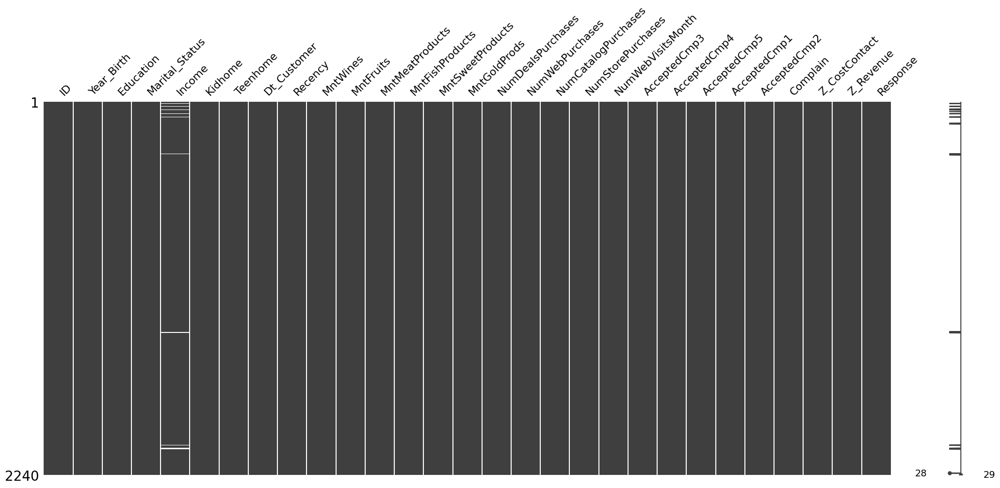

In [3]:
msno.matrix(df)

In [4]:
print('Number of missing values:',df['Income'].isna().sum())

Number of missing values: 24


    We can see that there are 24 missing values in the 'Incomes' column, which represents a small portion of the total data. Therefore, We are going to fill those missing values with the median, as it is less sensitive to outliers than the mean.

In [5]:
medianIncomes = df['Income'].median()
df['Income'].fillna(medianIncomes,inplace=True)

# Data exploration

##### We have a dataset containing 29 columns, and we are going to examine each column to visualize and detect any outliers. We will also identify any columns that are not useful or relevant for our analysis and drop them from the dataset.

In [6]:
print("Columns :", df.columns.array)

Columns : <PandasArray>
[                 'ID',          'Year_Birth',           'Education',
      'Marital_Status',              'Income',             'Kidhome',
            'Teenhome',         'Dt_Customer',             'Recency',
            'MntWines',           'MntFruits',     'MntMeatProducts',
     'MntFishProducts',    'MntSweetProducts',        'MntGoldProds',
   'NumDealsPurchases',     'NumWebPurchases', 'NumCatalogPurchases',
   'NumStorePurchases',   'NumWebVisitsMonth',        'AcceptedCmp3',
        'AcceptedCmp4',        'AcceptedCmp5',        'AcceptedCmp1',
        'AcceptedCmp2',            'Complain',       'Z_CostContact',
           'Z_Revenue',            'Response']
Length: 29, dtype: object


## ID :

##### The "ID" is simply a label assigned to the data for identification purposes and does not contribute to the similarity or dissimilarity between data points. Therefore, when performing clustering, it is common practice to drop the "ID" column from the dataset,

In [7]:
df.drop('ID',axis=1,inplace=True)


## Year of Birth

In [8]:
df['Year_Birth'].describe()

count    2240.000000
mean     1968.805804
std        11.984069
min      1893.000000
25%      1959.000000
50%      1970.000000
75%      1977.000000
max      1996.000000
Name: Year_Birth, dtype: float64

(array([  3.,   0.,   0.,   0.,  16., 300., 541., 685., 506., 189.]),
 array([1893. , 1903.3, 1913.6, 1923.9, 1934.2, 1944.5, 1954.8, 1965.1,
        1975.4, 1985.7, 1996. ]),
 <BarContainer object of 10 artists>)

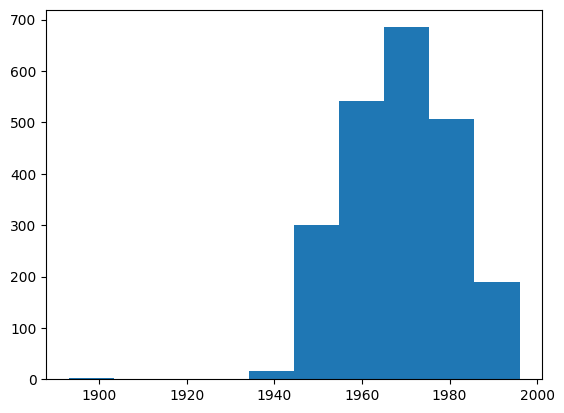

In [9]:
plt.hist(df['Year_Birth'], bins=10)

In [10]:
df.loc[df['Year_Birth'] < 1920 , 'Year_Birth']

192    1900
239    1893
339    1899
Name: Year_Birth, dtype: int64

    It seems that there are outliers in the year of birth values that are less than 1900.

In [11]:
df.loc[df['Year_Birth'] < 1920 , 'Year_Birth'] = df['Year_Birth'].median()  # Replace with median
# df = df[~(df['Year_Birth'] < 1900)]  # drop 

# Education

In [12]:
df['Education'].unique()

array(['Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'], dtype=object)

(array([1127.,    0.,  486.,    0.,    0.,  370.,    0.,   54.,    0.,
         203.]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. , 2.4, 2.8, 3.2, 3.6, 4. ]),
 <BarContainer object of 10 artists>)

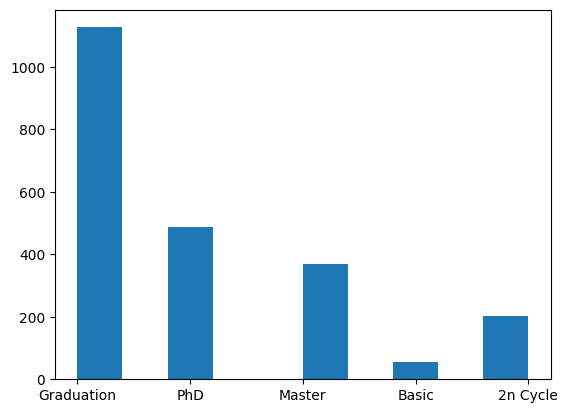

In [13]:
plt.hist(df['Education'])

In [14]:
df.replace({
    'Graduation':'Degree',
    'PhD':'Degree',
    'Master':'Degree',
    'Basic':'No Degree',
    '2n Cycle':'No Degree'
},inplace=True)

#### We can convert those values to numerical values by using label encoding.

In [15]:
le = LabelEncoder()
df['Education'] = le.fit_transform(df['Education'])
df['Education']

0       0
1       0
2       0
3       0
4       0
       ..
2235    0
2236    0
2237    0
2238    0
2239    0
Name: Education, Length: 2240, dtype: int32

# Marital Status

In [16]:
df['Marital_Status'].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone',
       'Absurd', 'YOLO'], dtype=object)

(array([480., 580., 864.,   0., 232.,  77.,   0.,   3.,   2.,   2.]),
 array([0. , 0.7, 1.4, 2.1, 2.8, 3.5, 4.2, 4.9, 5.6, 6.3, 7. ]),
 <BarContainer object of 10 artists>)

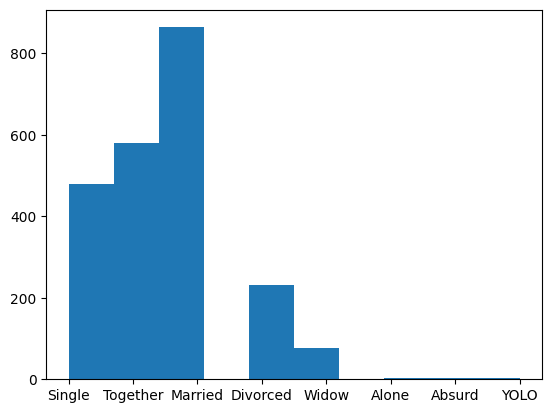

In [17]:
plt.hist(df['Marital_Status'])

We can convert all those value to two values only   
For <b style="color:blue;">(Single,Divorced,Widow,Alone,Absurd,YOLO)</b>  we can replace it with <b style="color:blue;">Alone or 0</b><br> 
For <b style="color:blue;">(Together,Married)</b>  we can replace it with <b style="color:blue;">Partner or 1</b> 

In [18]:
df['Marital_Status'].replace({
    "Married":1,
    "Together":1,
    "Alone":0,
    "Absurd":0,
    "Widow":0,
    "YOLO":0, 
    "Divorced":0,
    "Single":0
    },inplace=True)
df.head()

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,1957,0,0,58138.0,0,0,2012-09-04,58,635,88,...,7,0,0,0,0,0,0,3,11,1
1,1954,0,0,46344.0,1,1,2014-03-08,38,11,1,...,5,0,0,0,0,0,0,3,11,0
2,1965,0,1,71613.0,0,0,2013-08-21,26,426,49,...,4,0,0,0,0,0,0,3,11,0
3,1984,0,1,26646.0,1,0,2014-02-10,26,11,4,...,6,0,0,0,0,0,0,3,11,0
4,1981,0,1,58293.0,1,0,2014-01-19,94,173,43,...,5,0,0,0,0,0,0,3,11,0


# Income

In [19]:
df['Income'].describe()

count      2240.000000
mean      52237.975446
std       25037.955891
min        1730.000000
25%       35538.750000
50%       51381.500000
75%       68289.750000
max      666666.000000
Name: Income, dtype: float64

{'whiskers': [<matplotlib.lines.Line2D at 0x15b92605940>,
 'caps': [<matplotlib.lines.Line2D at 0x15b92605eb0>,
 'boxes': [<matplotlib.lines.Line2D at 0x15b926056a0>],
 'medians': [<matplotlib.lines.Line2D at 0x15b92616430>],
 'fliers': [<matplotlib.lines.Line2D at 0x15b926166d0>],
 'means': []}

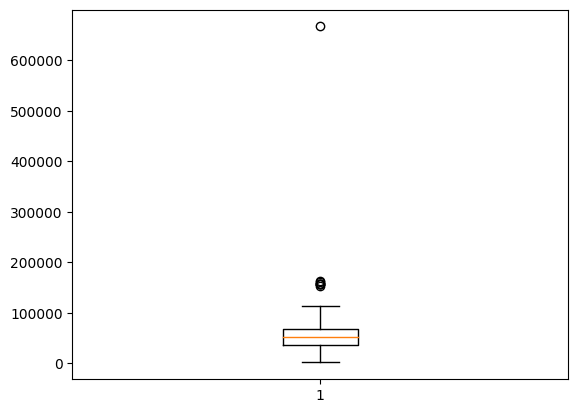

In [20]:
plt.boxplot(df['Income'])

    We can see that there is a very high value in the income column compared to the others, so I plan to replace it with the mean.

In [21]:
df.loc[df['Income'] > 600000,'Income'] = df['Income'].median()


## Kidhome & Teenhome

##### We can combine those two columns to create a new one named 'NumOfKids'.

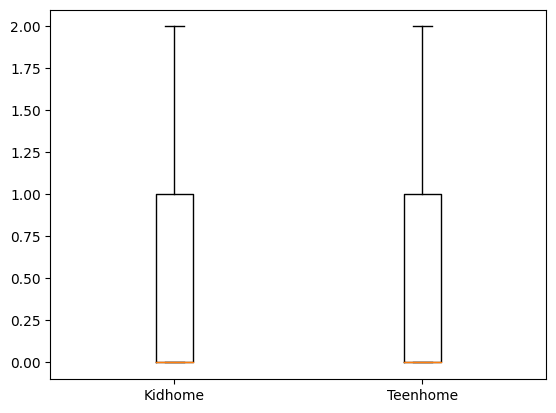

In [22]:
plt.boxplot([df['Kidhome'],df['Teenhome']],labels=['Kidhome','Teenhome'])
plt.show()


In [23]:
df['NumOfKid'] = df['Kidhome']+df['Teenhome']
df.head()

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,NumOfKid
0,1957,0,0,58138.0,0,0,2012-09-04,58,635,88,...,0,0,0,0,0,0,3,11,1,0
1,1954,0,0,46344.0,1,1,2014-03-08,38,11,1,...,0,0,0,0,0,0,3,11,0,2
2,1965,0,1,71613.0,0,0,2013-08-21,26,426,49,...,0,0,0,0,0,0,3,11,0,0
3,1984,0,1,26646.0,1,0,2014-02-10,26,11,4,...,0,0,0,0,0,0,3,11,0,1
4,1981,0,1,58293.0,1,0,2014-01-19,94,173,43,...,0,0,0,0,0,0,3,11,0,1


In [24]:
df['NumFamily'] = 1 + df['Marital_Status'] + df['NumOfKid']

# Dt_Customer

#### Convert the 'Dt_Customer' column from type 'str' to type 'date' and then to toordinal()

In [25]:
df['Dt_Customer'].describe()

count           2240
unique           663
top       2012-08-31
freq              12
Name: Dt_Customer, dtype: object

In [26]:
df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer']).apply(lambda x: x.toordinal())
df.head()

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,NumOfKid,NumFamily
0,1957,0,0,58138.0,0,0,734750,58,635,88,...,0,0,0,0,0,3,11,1,0,1
1,1954,0,0,46344.0,1,1,735300,38,11,1,...,0,0,0,0,0,3,11,0,2,3
2,1965,0,1,71613.0,0,0,735101,26,426,49,...,0,0,0,0,0,3,11,0,0,2
3,1984,0,1,26646.0,1,0,735274,26,11,4,...,0,0,0,0,0,3,11,0,1,3
4,1981,0,1,58293.0,1,0,735252,94,173,43,...,0,0,0,0,0,3,11,0,1,3


# Recency

(array([233., 223., 236., 214., 216., 234., 213., 224., 229., 218.]),
 array([ 0. ,  9.9, 19.8, 29.7, 39.6, 49.5, 59.4, 69.3, 79.2, 89.1, 99. ]),
 <BarContainer object of 10 artists>)

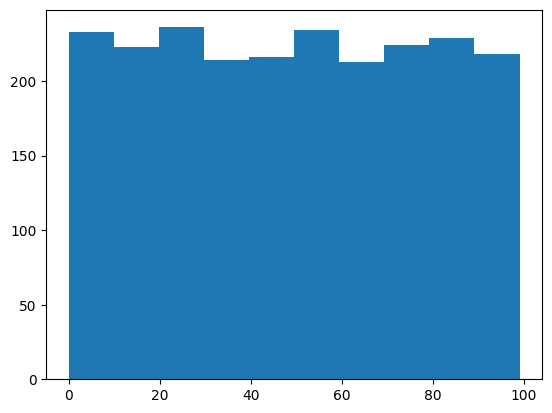

In [27]:
plt.hist(df['Recency'])

# Montant

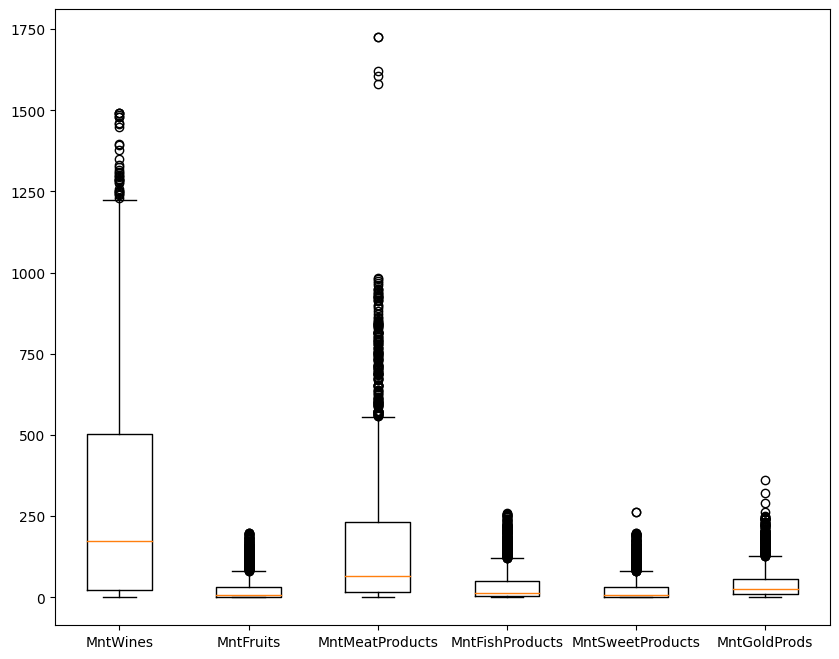

In [28]:
columns = ['MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds']
plt.figure(figsize=(10,8))
plt.boxplot(df[columns],labels=columns)
plt.show()

##### We can create a new column named "MntTotal" that contains the sum of all the amounts in the "Montant" column.

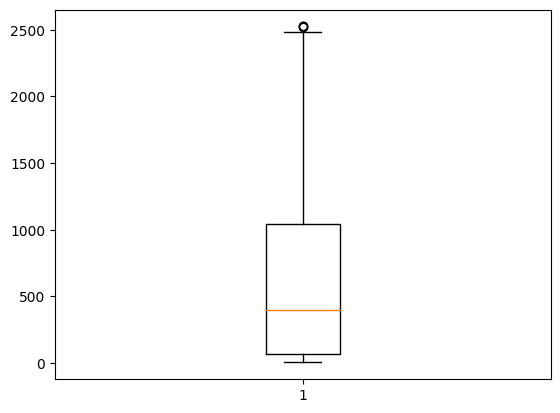

In [29]:
df['MntTotal'] = df[columns].sum(axis=1)
plt.boxplot(df['MntTotal'])
plt.show()

# Z_CostContact & Z_Revenue

In [30]:
print('Unique value of Z_CostContact column :',df['Z_CostContact'].unique())
print('Unique value of Z_Revenue column :',df['Z_Revenue'].unique())

Unique value of Z_CostContact column : [3]
Unique value of Z_Revenue column : [11]


    Since we can observe that all the values in those two columns are constant, we should drop them from the dataset,Constant columns do not provide any useful information to the clustering process, and including them can actually lead to poorer clustering performance.

In [31]:
df.drop(['Z_CostContact','Z_Revenue'],axis=1,inplace=True)
df.head()

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,NumOfKid,NumFamily,MntTotal
0,1957,0,0,58138.0,0,0,734750,58,635,88,...,0,0,0,0,0,0,1,0,1,1617
1,1954,0,0,46344.0,1,1,735300,38,11,1,...,0,0,0,0,0,0,0,2,3,27
2,1965,0,1,71613.0,0,0,735101,26,426,49,...,0,0,0,0,0,0,0,0,2,776
3,1984,0,1,26646.0,1,0,735274,26,11,4,...,0,0,0,0,0,0,0,1,3,53
4,1981,0,1,58293.0,1,0,735252,94,173,43,...,0,0,0,0,0,0,0,1,3,422


# NumDealsPurchases, NumWebPurchases, NumCatalogPurchases, NumStorePurchases

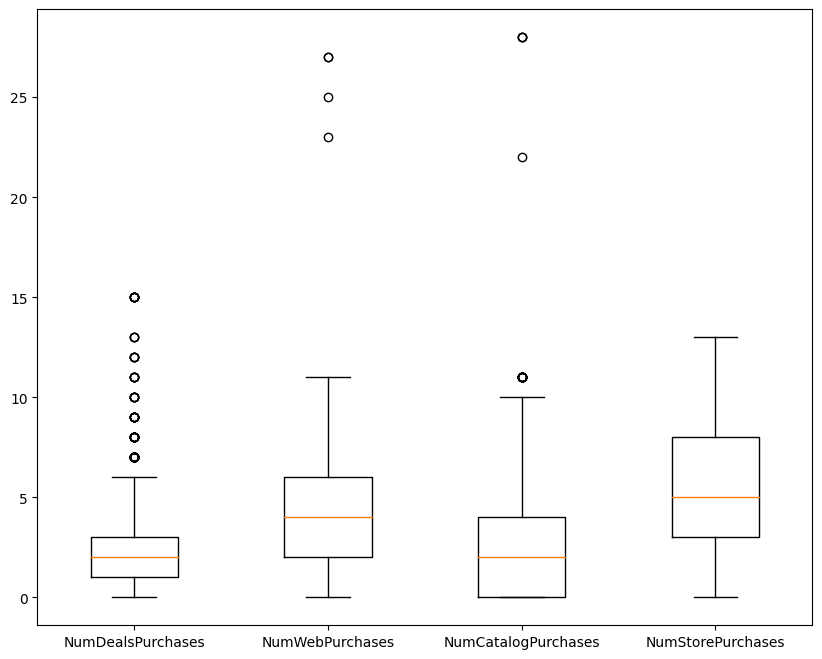

In [32]:
columns = ['NumDealsPurchases','NumWebPurchases', 'NumCatalogPurchases','NumStorePurchases']
plt.figure(figsize=(10,8))
plt.boxplot(df[columns],labels=columns)
plt.show()

##### We can create a new column named "PurchasesTotal" that contains the sum of all the amounts in the Purchases columns.

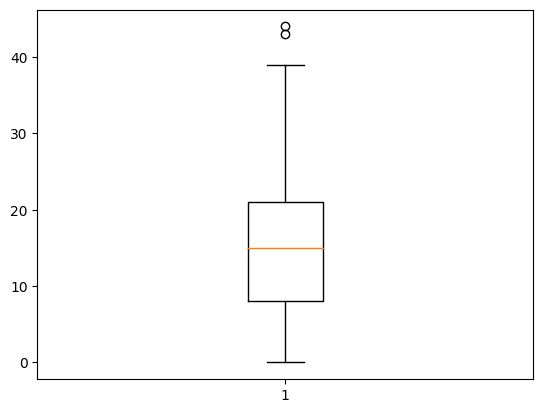

In [33]:
df['PurchasesTotal'] = df[columns].sum(axis=1)
plt.boxplot(df['PurchasesTotal'])
plt.show()

# Removing Deals and Promotions

In [34]:
cols_del = ['AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1','AcceptedCmp2', 'Complain', 'Response']
# X = df.drop(cols_del,axis=1)
X = df

# HeatMap

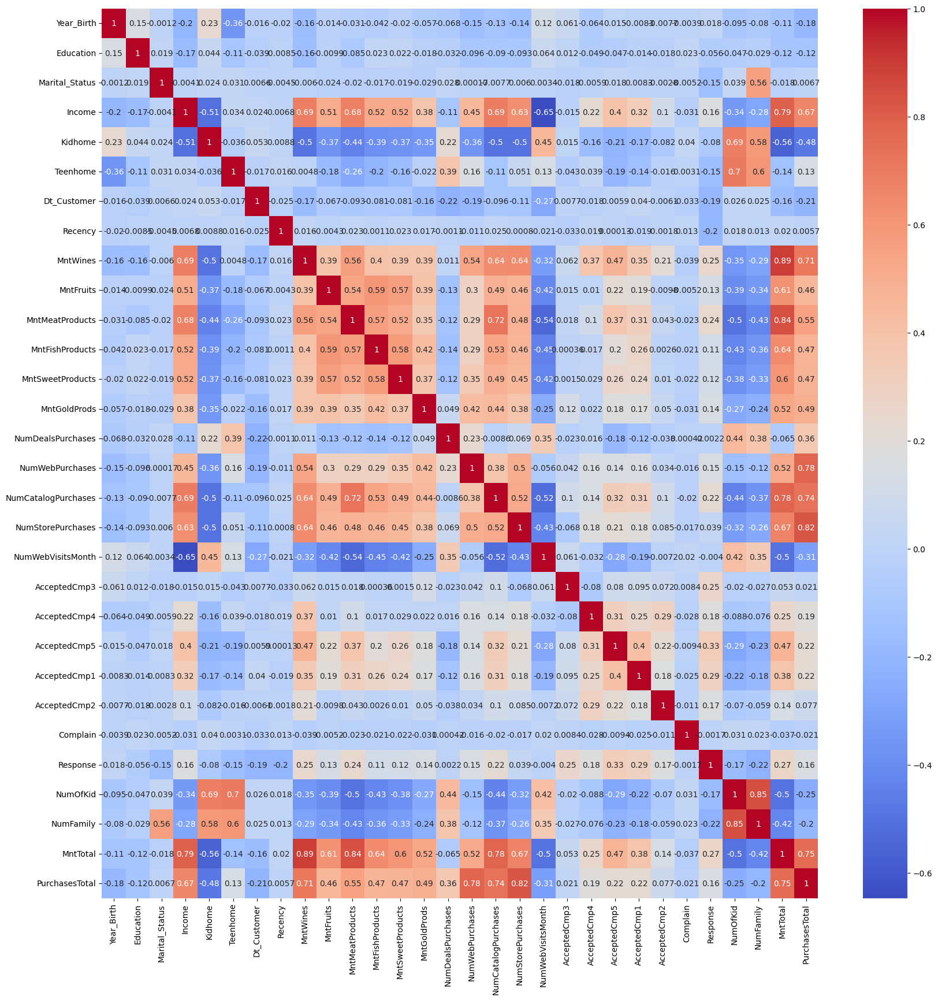

In [35]:
# columns = ['Year_Birth','Education', 'Recency','Marital_Status','NumOfKid','Income','Dt_Customer','MntTotal','PurchasesTotal']
corr_matrix = df.corr()
plt.figure(figsize=(20, 20))
sns.heatmap(corr_matrix, cmap='coolwarm', annot=True)
plt.show()

# Testing different unsupervised clustering models to pick the best one.

# K-means:

#### The elbow method to  determine the optimal number of clusters in KMeans clustering

Elbow Method to determine the number of clusters to be formed:


c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `

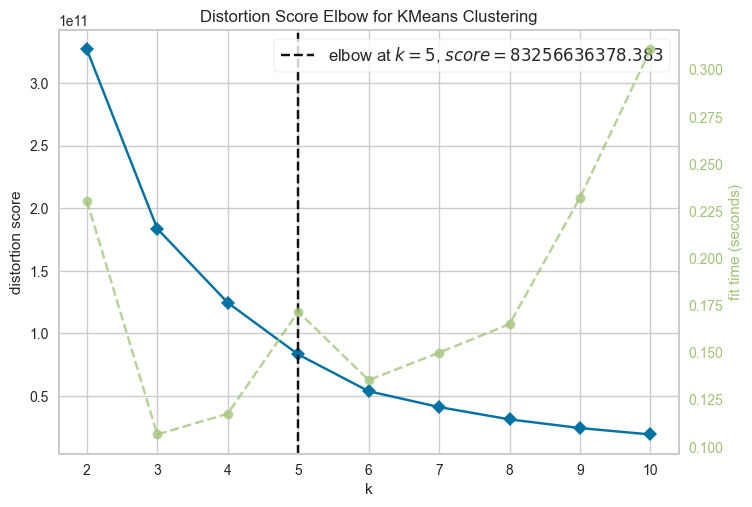

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [36]:
from yellowbrick.cluster import KElbowVisualizer

print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k=10)
Elbow_M.fit(X)
Elbow_M.show()

    The optimal number of clusters based on the elbow method is 5, but the 5th cluster is very small compared to the others. Therefore, we choose to use only 4 clusters.

In [37]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score



kmeans = KMeans(n_clusters=4, random_state=0).fit(X)


silhouette_score = silhouette_score(X, kmeans.labels_, metric='euclidean')

y_pred = kmeans.fit_predict(X)
X['cluster'] = y_pred
ch_score = calinski_harabasz_score(X, y_pred)
db_score = davies_bouldin_score(X, y_pred)

print(f"Silhouette score: {silhouette_score}")
print("Calinski-Harabasz score:", ch_score)
print("Davies-Bouldin index:", db_score)

c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette score: 0.5229194404697339
Calinski-Harabasz score: 5401.208931439283
Davies-Bouldin index: 0.569338171989423


c:\Users\ayoub\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [38]:
X.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'NumOfKid', 'NumFamily',
       'MntTotal', 'PurchasesTotal', 'cluster'],
      dtype='object')

{
   'Year_Birth' : 1,
   'Education': 2,
   'Marital_Status':3,
   'Income' : 4,
   'Kidhome' : 5,
   'Teenhome': 6,
   'Dt_Customer': 7,
   'Recency': 8,
   'MntWines' : 9,
   'MntFruits': 10,
   'MntMeatProducts' : 11,
   'MntFishProducts': 12,
   'MntSweetProducts': 13,
   'MntGoldProds': 14,
   'NumDealsPurchases': 15,
   'NumWebPurchases':16,
   'NumCatalogPurchases':17,
   'NumStorePurchases' : 18,
   'NumWebVisitsMonth':19,
   'AcceptedCmp3':20,
   'AcceptedCmp4': 21 ,
   'AcceptedCmp5': 22,
   'AcceptedCmp1' : 23,
   'AcceptedCmp2' : 24,
   'Complain' : 25,
   'Response' : 26,
   'NumOfKid' : 27,
   'NumFamily' : 28,
   'MntTotal' : 29,
   'PurchasesTotal':30,
   'cluster'
}

## Check the  image pairplot.png 

In [40]:
# vis_col_1 = ['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Dt_Customer', 'Recency','NumOfKid', 'NumFamily', 'MntTotal', 'PurchasesTotal','cluster']
# vis_col_2 = ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases','cluster']
# vis_col_3 = ['NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth','AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1','AcceptedCmp2', 'Complain', 'Response','cluster']
# sns.pairplot(X, hue='cluster')
# plt.savefig('pairplot.png', dpi=300)

    We can see from the pairplot that the variables "income", "mntTotal", and "Purchases Total" have some obvious observations, and therefore our analysis will be based on these variables and their relationship with the other variables.

# Clusters 

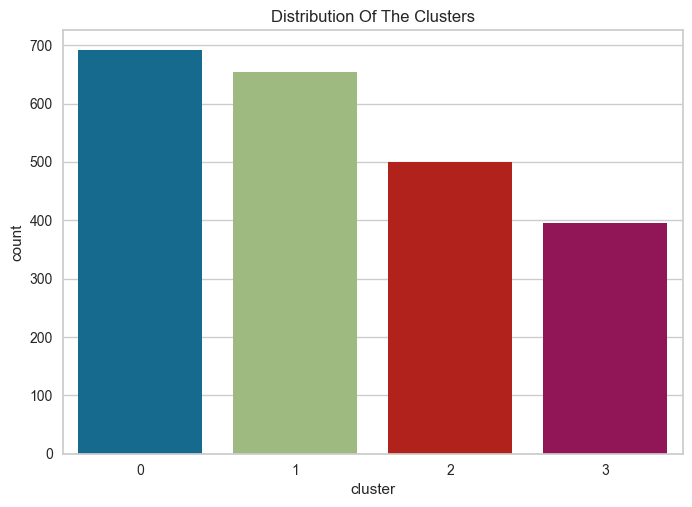

In [47]:
pl = sns.countplot(x=X["cluster"])
pl.set_title("Distribution Of The Clusters")
plt.show()

### The relationship between "income", "Purchases Total", and "mntTotal".

<Figure size 1500x800 with 0 Axes>

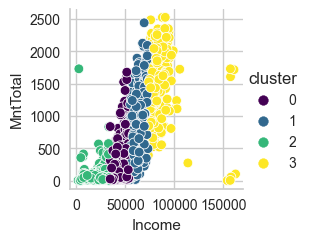

In [54]:
plt.figure(figsize=(15,8))
g = sns.PairGrid(df, x_vars=["Income"], y_vars=["MntTotal"], hue='cluster', palette='viridis')
g.map(sns.scatterplot)
g.add_legend()
plt.show()

    We can see that 

    Group 0 represents customers with low to average income and low to average spending,
    Group 1 represents customers with average to high income and average to high spending,
    Group 2 represents customers with low income and low spending, 
    Group 3 represents customers with high income and high spending.


### The relashion between Clusters and Family members

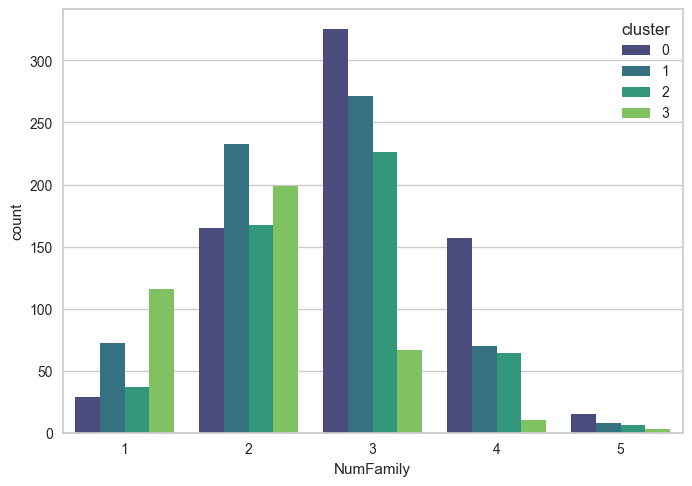

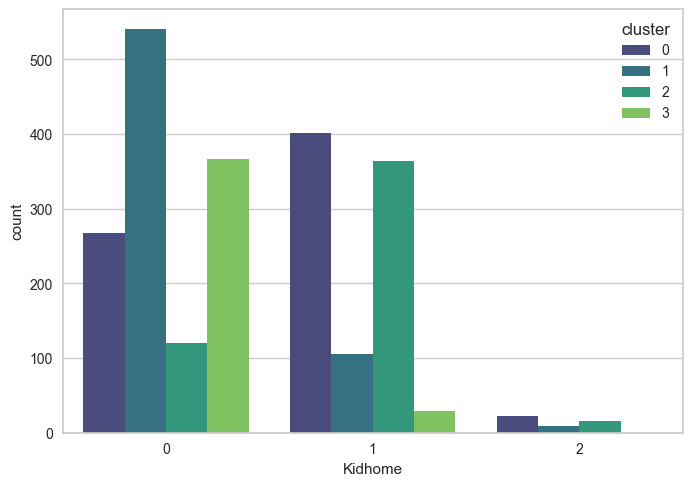

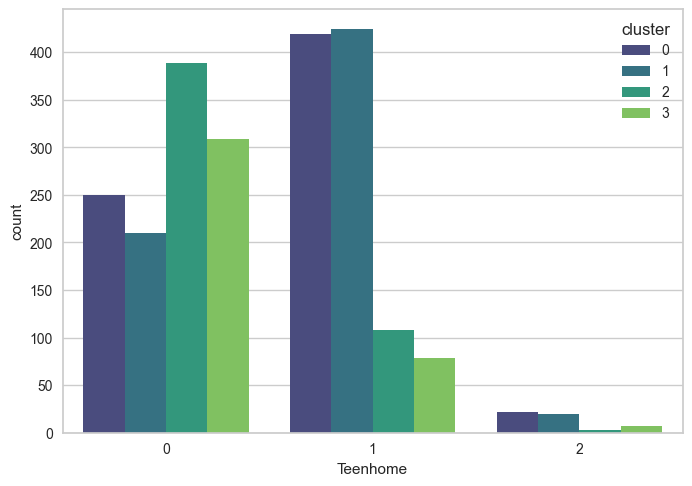

In [60]:
for val in ['NumFamily','Kidhome','Teenhome']:
    sns.countplot(x=val, hue='cluster', data=df, palette='viridis')
    plt.show()

    We can see that :
        Group 0,1 and 2 are most likely to have kid(tennager or young) 
        Group 3 : most likely to be single or in relashionship  with no kids 
        Group 0,1 : are most likely to have teenagers than the  group number 2
        Group 0,2 : are more likely to have kids  that group number 1

### Each cluster and His spending 

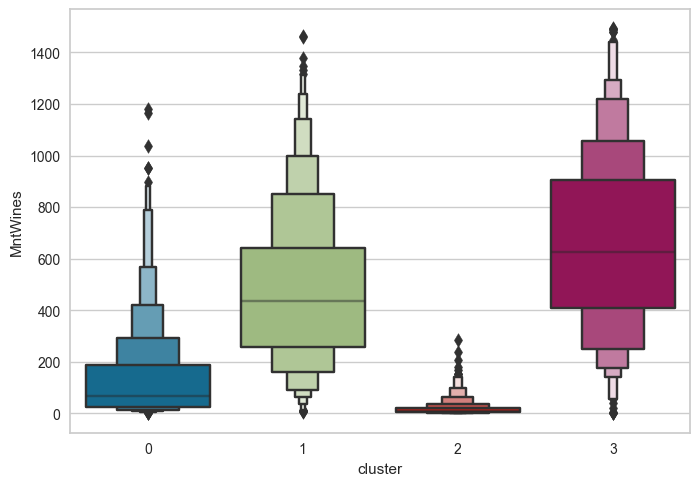

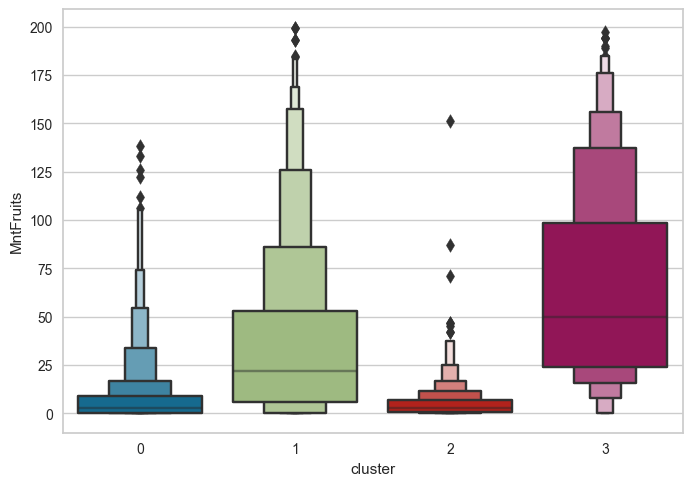

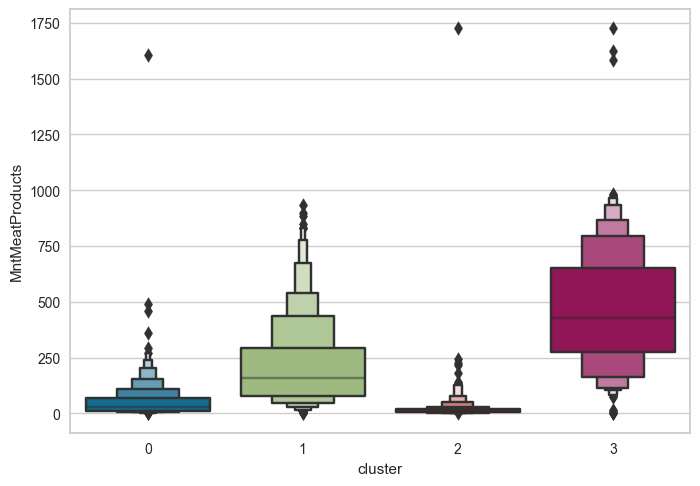

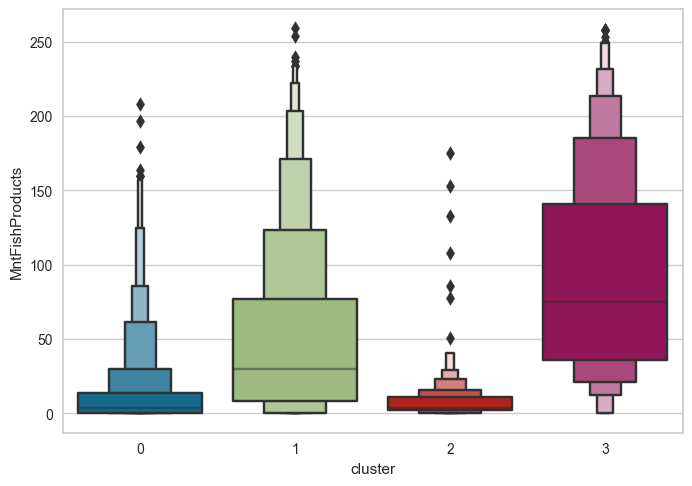

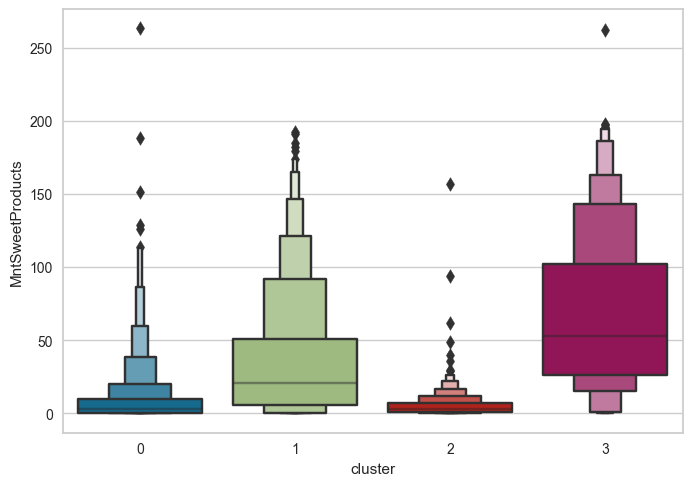

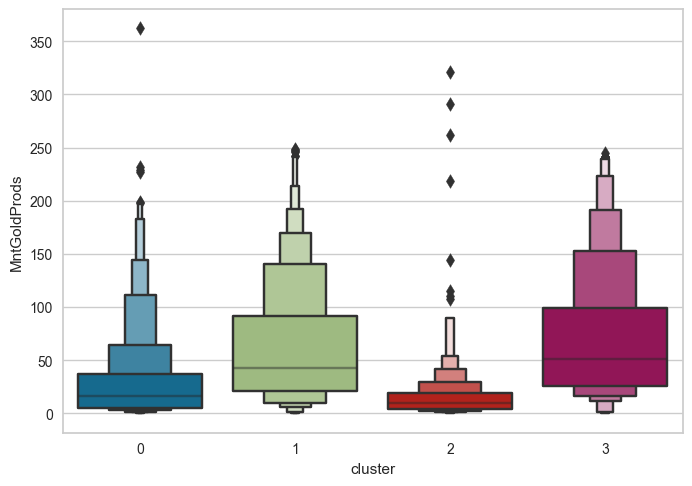

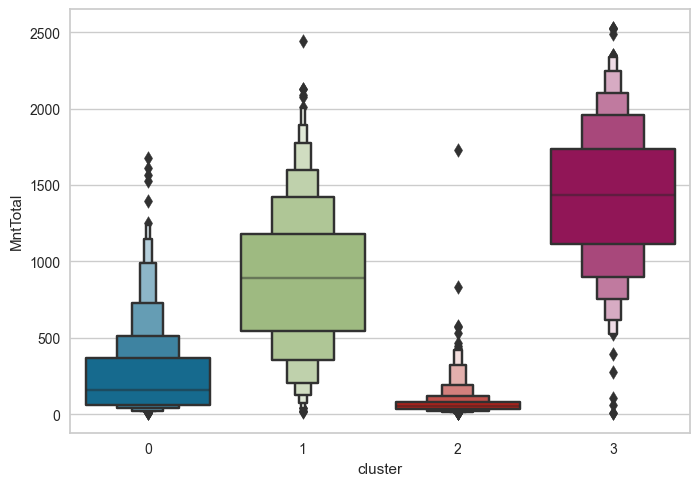

In [79]:
for val in ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds','MntTotal']:
    sns.boxenplot(x=X["cluster"], y=X[val])
    
    plt.show()


### Clusters and promotions 

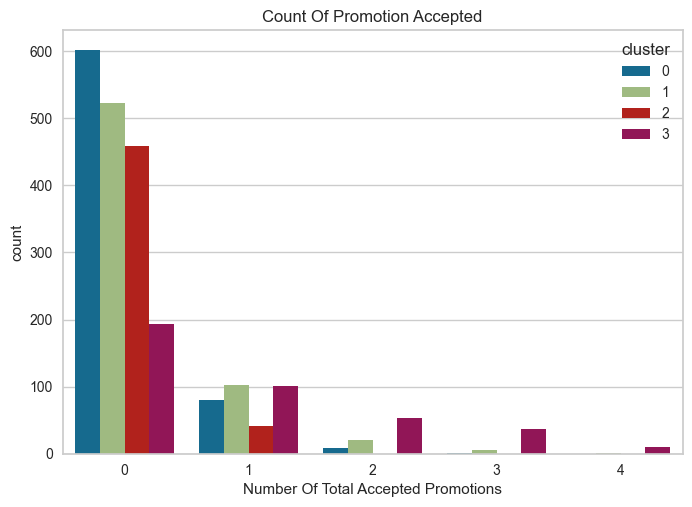

In [81]:
X["Total_Promos"] = X["AcceptedCmp1"]+ X["AcceptedCmp2"]+ X["AcceptedCmp3"]+ X["AcceptedCmp4"]+ X["AcceptedCmp5"]
plt.figure()
pl = sns.countplot(x=X["Total_Promos"],hue=X["cluster"])
pl.set_title("Count Of Promotion Accepted")
pl.set_xlabel("Number Of Total Accepted Promotions")
plt.show()

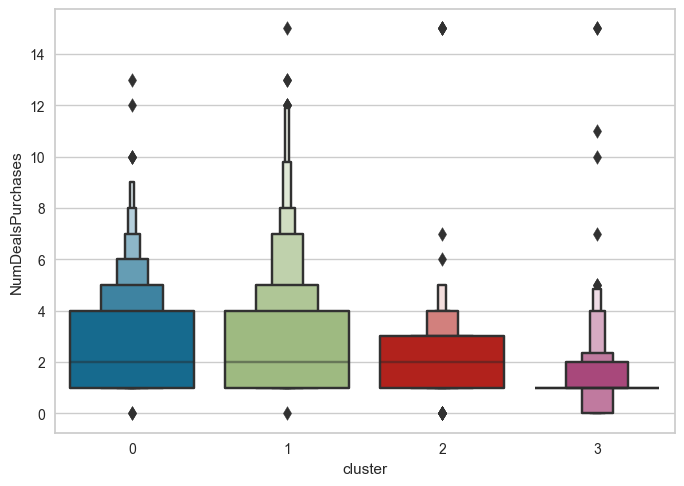

In [82]:

sns.boxenplot(x=X["cluster"], y=X['NumDealsPurchases'])    
plt.show()

    Based on our analysis, we found that Group 3 is the most likely to benefit from promotions, followed by Group 1 and Group 0. Group 2 is the least likely to benefit from promotions among the four groups. This suggests that targeting promotional offers to Groups 3, 1, and 0 may yield better results in terms of increasing sales or customer engagement, compared to targeting Group 2.

### Relation between age and spending 

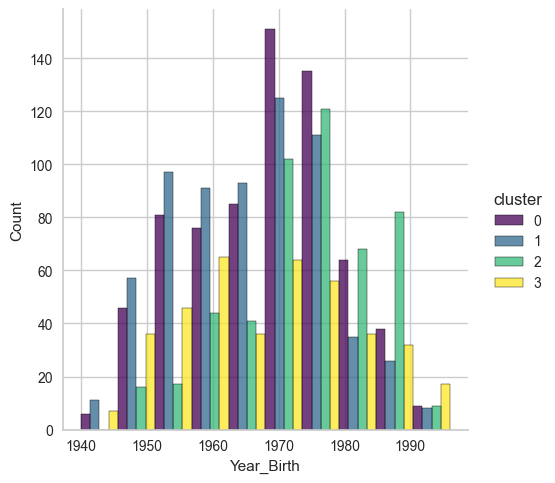

In [95]:
sns.displot(data=df, x="Year_Birth", hue="cluster", multiple="dodge", palette="viridis",bins=10)

# Conclusion 

<table style="margin:auto;">
<tr>
<th></th>
<th>Group 0</th>
<th>Group 1</th>
<th>Group 2</th>
<th>Group 3</th>
</tr>

<tr>
<td>Income</td>
<td>Low to Average</td>
<td>Average to High</td>
<td>Low</td>
<td>High</td>
</tr>
<tr>
<td>Spending</td>
<td>Low To Average</td>
<td>Average to High</td>
<td>Low</td>
<td>High</td>
</tr>
<tr>
<td>Family member</td>
<td>Most Likely to have Child(kids or teen)</td>
<td>Most Likely to have Child(teen)</td>
<td>Most Likely to have Child(kid)</td>
<td>Most Likely to be single or in relashionship with no kids</td>
</tr>

<tr>
<td>Most likely to benefit from promotions</td>
<td>2nd</td>
<td>3rd</td>
<td>4th</td>
<td>1th</td>
</tr>

<tr>
<td>Age Distribution </td>
<td>The majority born before 1980 </td>
<td>Majority Old</td>
<td>Majority younger</td>
<td>Diffrent Ages</td>
</tr>
<tr>
<td>promotions </td>
<td colspan="4">The majority doesn't benefits from promotions </td>

</tr>


</table>